# Research Question 1 - Hubs and Authorities

Does the association to Climate Change topics on Reddit relate to extreme climate events?
- Hypothesis: Yes, it does - there is a relation between physical events related to climate change and the activity on Reddit.

Before answering this Research Question (RQ) a selection of modules and useful functions will be imported.

## 1) Import packages

In [1]:
import os
import pickle
from pathlib import Path
from tqdm import tqdm

import matplotlib as mpl
import matplotlib.pyplot as plt

import numpy as np
import pandas as pd

from statsmodels.tsa.api import VAR
from statsmodels.tsa.stattools import adfuller, grangercausalitytests
from scipy.stats import pearsonr

import plotly.express as px
import plotly.graph_objects as go

import warnings
warnings.filterwarnings('ignore')

In [2]:
from plotly.subplots import make_subplots

def make_subplots_from_px(figs, title, x_labels = False, y_labels = False, unified_hover=True):
    fig_traces = [[],[],[]]
       
    for i, fig in enumerate(figs):
        for trace in range(len(fig["data"])):
            fig_traces[i].append(fig["data"][trace])   

    fig = make_subplots(rows=len(figs), cols=1, vertical_spacing=0.07)

    for i in range(len(figs)):
        for traces in fig_traces[i]:
            fig.append_trace(traces, row=i+1, col=1)  

    if unified_hover:    
        fig.update_layout(hovermode="x unified")    
    
    fig.update_traces(xaxis="x"+str(len(figs)))
    
    if x_labels:
        for i in range(len(figs)):

            # Update xaxis properties
            fig.update_xaxes(title_text=x_labels[i], row=i+1, col=1)

            # Update yaxis properties
            fig.update_yaxes(title_text=y_labels[i], row=i+1, col=1)
    
    # Making sure classes only show up once in legend
    names = set()
    fig.for_each_trace(lambda trace: trace.update(showlegend=False) if (trace.name in names) else names.add(trace.name))
    
    fig.update_layout(height=600, width=800, title_text=title)
    
    return fig

In [3]:
# Data directory
DATA_DIR = Path(os.getcwd()) / 'data'

## 2) Load data

In order to answer research question 1, three sets of data was collected. 

1) Submissions and 2) comments from Reddit, containing an opinion score on climate change. 3) Natural Disaster dataset, containing dates, countries, types, deaths and total number of affected people regarding each natural disaster, within the last 8 years. A period from the 1/1-2014, up until now, 1/5-2022.

Here the data is loaded...

In [4]:
# load submissions
submissions = pd.DataFrame([])

for year in tqdm([2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022]):
    temp =  pd.read_json(f'{DATA_DIR}{os.sep}{year}{os.sep}submissions_opinion_{year}.json.bz2')
    submissions = pd.concat([submissions, temp])

submissions.reset_index(inplace=True) 
submissions.to_json(f'{DATA_DIR}{os.sep}/submissions_opinion.json.bz2')
submissions = submissions.set_index('date')

100%|██████████| 9/9 [01:45<00:00, 11.67s/it]


In [5]:
# load comments
comments = pd.DataFrame([])

for year in tqdm([2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022]):
    temp = pd.read_json(f'{DATA_DIR}{os.sep}{year}{os.sep}comments90k_opinion_{year}.json.bz2')
    comments = pd.concat([comments, temp])    

comments.reset_index(inplace=True)
comments.to_json(f'{DATA_DIR}{os.sep}/comments90k_opinion.json.bz2')
comments = comments.set_index('date')

100%|██████████| 9/9 [00:58<00:00,  6.54s/it]


In [6]:
# combine these in one dataframe
posts = pd.concat([comments, submissions])

The opnion labels needs to be represented numerically. This is done with the following conversion dictionary.

In [7]:
conversion_dict = {'Neutral': 0, 'Pro': 1, 'Anti': -1, 'News': np.nan}
posts['opinion'] = posts['opinion'].apply(lambda x: conversion_dict[x])

Grouping dataframes by dates, and keeping columns containing opinion score and number of posts, which is what is needed to answer this research question.

In [8]:
# Grouping by dates - saving num_posts and mean opinion score
posts_daily = posts.groupby(['date']).count()
posts_daily['opinion'] = posts.groupby(['date'])['opinion'].mean()

# Number of posts is equal to summed id's, change name
posts_daily = posts_daily.rename(columns={"id": "number_of_posts"})

# Only keep number of posts and avg. opinion
posts_daily = posts_daily[['number_of_posts','opinion']]

# Converting column to datetime
posts_daily.index = pd.to_datetime(posts_daily.index, infer_datetime_format=False) 
posts_daily.head()

,number_of_posts,opinion
date,,
2014-11-01,77,-0.014925
2014-11-02,81,0.175439
2014-11-03,81,0.098361
2014-11-04,464,-0.078300
2014-11-05,2742,-0.208440


In [9]:
# load natural disaster event dataset
events = pd.read_csv(DATA_DIR / 'emdat_processed.csv')

## 3) Analysis


### 3.1) Daily 'hype' vs. opinion

Firstly, we will want to investigate whether there's any correlation between the number of posts and the daily average opinion-score. This will be investigated in a subplot with a shared time-axis, showing the weekly rolling average, as well as the actual values, plotted together. Seconly, a figure which explores one variable as a function of the other will be plotted. Lastly, the Pearson correlation is calculated. 


In [10]:
opinion_fig = px.line(posts_daily, x=posts_daily.index, y=posts_daily.opinion)
posts_fig = px.line(posts_daily, x=posts_daily.index, y=posts_daily.number_of_posts)

rolling_weekly_opinion = pd.DataFrame(posts_daily.opinion.rolling(7).mean())
rolling_weekly_posts = pd.DataFrame(posts_daily.number_of_posts.rolling(7).mean())
roll_opinion_fig = px.line(rolling_weekly_opinion, x=rolling_weekly_opinion.index, y=rolling_weekly_opinion.opinion)
roll_posts_fig = px.line(rolling_weekly_posts, x=rolling_weekly_posts.index, y=rolling_weekly_posts.number_of_posts)

opinion_fig = go.Figure(data=opinion_fig.data + roll_opinion_fig.data)
posts_fig = go.Figure(data=posts_fig.data + roll_posts_fig.data)

# Adjusting lines in plots
for (key, value) in zip(['color', 'dash', 'width'], ['#add8e6', 'dash', 1]):
    opinion_fig['data'][0]['line'][key]=value
    posts_fig['data'][0]['line'][key]=value
for (key, value) in zip(['color', 'width'], ['#36454f', 1.5]):
    opinion_fig['data'][1]['line'][key]=value
    posts_fig['data'][1]['line'][key]=value

for i, text in enumerate(['Normal', 'Weekly Rolling Avg.']):
    opinion_fig['data'][i]['name'] = text
    posts_fig['data'][i]['name'] = text
    opinion_fig['data'][i]['showlegend'] = True
    posts_fig['data'][i]['showlegend'] = True
    
opinion_fig.update_traces(
    hovertemplate="<br>".join([
        "Date:  %{x}",
        "Avg. Opinion: %{y}",
    ])
)

posts_fig.update_traces(
    hovertemplate="<br>".join([
        "Date:  %{x}",
        "Number of posts: %{y}",
    ])
)

fig = make_subplots_from_px([posts_fig, opinion_fig], 'Opinion vs. Daily posts', x_labels = ['', 'Date'], y_labels = ['Number of posts', 'Opinion score'])
fig.show()

fig.write_html("Fig1hypeVsOpinion.html", full_html=False, include_plotlyjs='cdn')

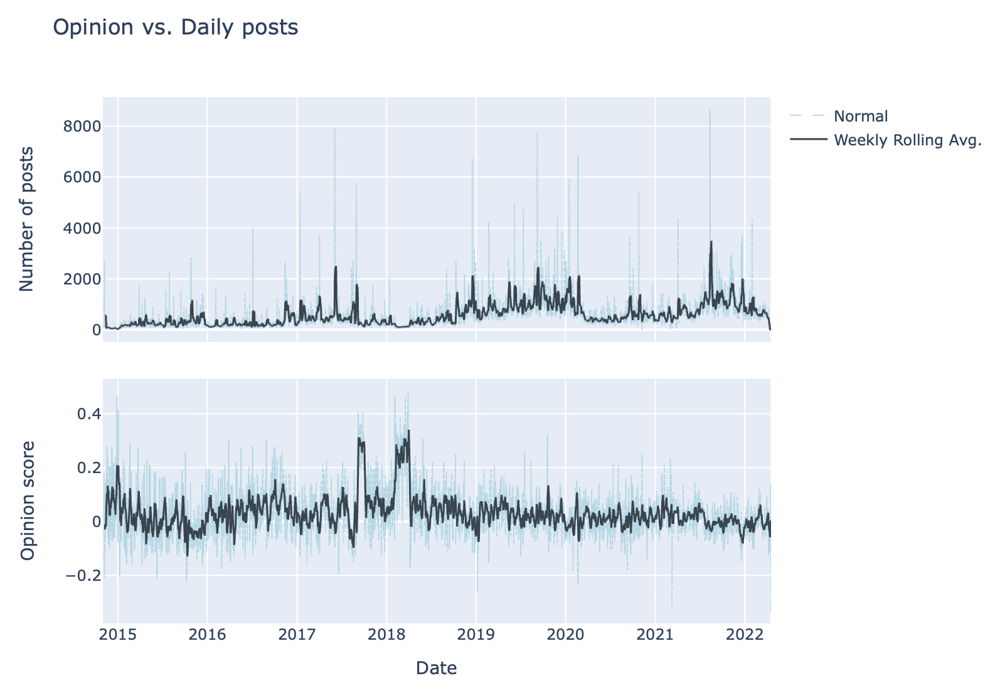

The two plots don't seem to immediately suggest any correlation between the two. To make completely sure, the two will be plotted as a function of one-another - while also calculating the Pearson correlation, i.e. a statistical test, with a null-hypothesis stating that the correlation coefficient is not significantly different from 0.

In [25]:
# correlation formula correspond to pearson correlation. Calculate significance (p-value) and corr. with scipy
corr_coef, p = pearsonr(posts_daily.number_of_posts, posts_daily.opinion)
print(f"Correlation coefficient = {corr_coef :.2f} \np-value \t\t= {p:.140f}")

scatter = px.scatter(posts_daily.reset_index(), x=posts_daily.number_of_posts, y=posts_daily.opinion, custom_data=['date'])
scatter.update_xaxes(title_text='Number of posts', row=1, col=1)
scatter.update_yaxes(title_text='Avg. Opinion', row=1, col=1)
scatter.update_traces(
    hovertemplate="<br>".join([
        "Number of posts:  %{x}",
        "Avg. Opinion: %{y}",
        "Date: %{customdata[0]}"
    ])
)
scatter.write_html("Fig2numPostsOpinion.html", full_html=False, include_plotlyjs='cdn')
scatter.show()

Correlation coefficient = -0.35 
p-value 		= 0.00000000000000000000000000000000000000000000000000000000000000000000000000000001606580716218241849138005612096262888209033671085779541387606


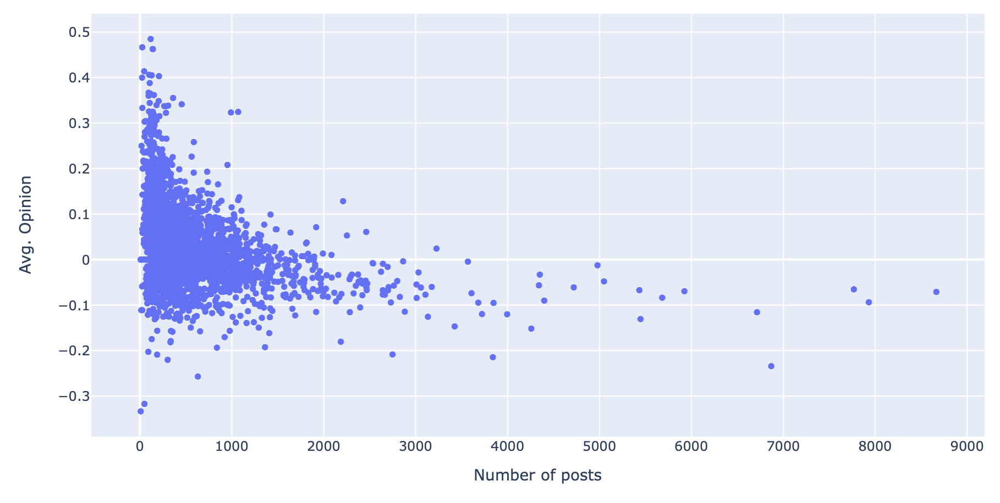

The newly plotted plot, as well as the pearson correlation seem to suggest that the two are correlated! The plot seems to suggest that days with an average Anti-opinion seem to have more posts than days of Pro-opinions. The Pearson correlation suggests that there is a significant correlation, as the P-value is below 0.05. 

### 3.2) Real World data - Natural Disasters

Now we'd like to take the real world data of natural disasters into account. To see whether the severity of natural disasters influence the opinion of the Redditors.

Firstly, we will scatter the disasters directly on top of our previously found plots, only based on time. As a quick visualization. In order to do this, we'll have to merge the dataframes. 

In [12]:
# Merging data:
events['date'] = pd.to_datetime(events['date'])
events = events.set_index('date')
merged_df = pd.merge(events, rolling_weekly_opinion, how='inner', on=['date'])
merged_df = pd.merge(merged_df, rolling_weekly_posts, how='inner', on=['date'])
merged_df = merged_df.sort_values(by="date")

In [13]:
event_opinion_fig = px.scatter(merged_df, x=merged_df.index, y=merged_df.opinion, color=merged_df['disaster type'], custom_data=['disaster type', 'mean deaths', 'mean affected'])
event_posts_fig = px.scatter(merged_df, x=merged_df.index, y=merged_df.number_of_posts, color=merged_df['disaster type'], custom_data=['disaster type', 'mean deaths', 'mean affected'])

event_opinion_fig.update_traces(
    hovertemplate="<br>".join([
        "Mean Deaths: %{customdata[1]}",
        "Mean Affected: %{customdata[2]}",        
    ])
)

event_posts_fig.update_traces(
    hovertemplate="<br>".join([
        "Mean Deaths: %{customdata[1]}",
        "Mean Affected: %{customdata[2]}",        
    ])
)

event_opinion_fig.update_traces(marker={'size': 3})
event_posts_fig.update_traces(marker={'size': 3})

opinion_fig = go.Figure(data=opinion_fig.data + event_opinion_fig.data)
posts_fig = go.Figure(data=posts_fig.data + event_posts_fig.data)

# Adjusting lines in plots
for (key, value) in zip(['color', 'dash', 'width'], ['#add8e6', 'dash', 1]):
    opinion_fig['data'][0]['line'][key]=value
    posts_fig['data'][0]['line'][key]=value
for (key, value) in zip(['color', 'width'], ['#36454f', 1.5]):
    opinion_fig['data'][1]['line'][key]=value
    posts_fig['data'][1]['line'][key]=value
     
fig = make_subplots_from_px([posts_fig, opinion_fig], 'Opinion vs. Daily posts - Natural Disasters', x_labels = ['', 'Date'], y_labels = ['Number of posts', 'Avg. Opinion'])
fig.write_html("fig3naturalDisasters.html", full_html=False, include_plotlyjs='cdn')
fig.show()

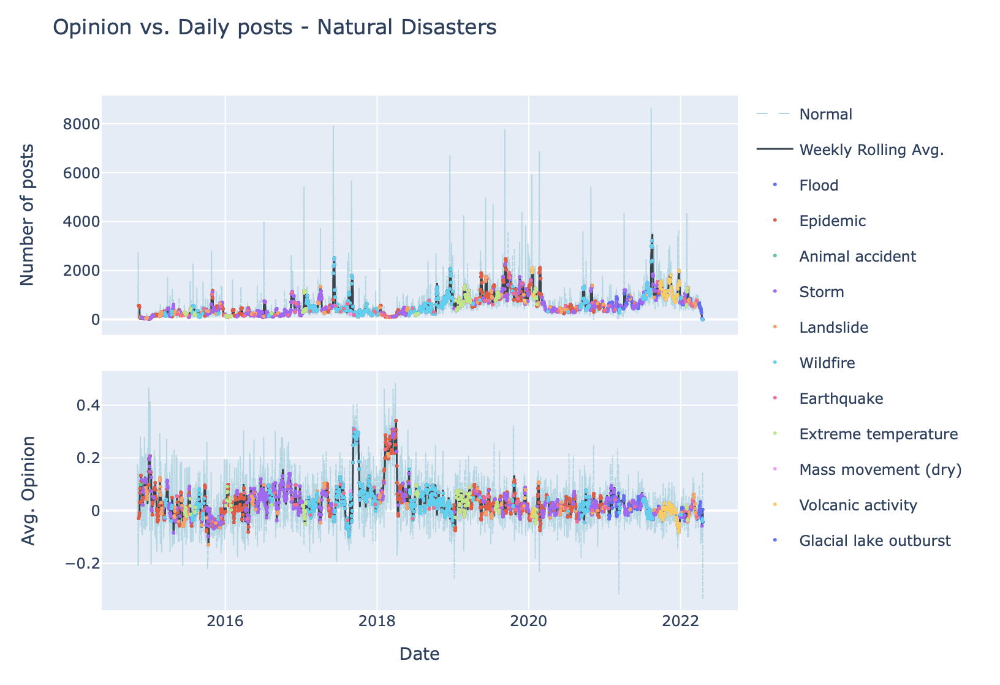

The plots seem to show clear divisions among disaster-types wrt. time, as would be expected as some Natural Disasters only occur within a specific span of months within a year. That's not what should be taken away from this plot however. One would expect the events to stay within the peaks of the collected data, if they influnced the Redditors - this however is not the case. 

Now, we'll take a look at whether the severity of the disaster has any correlation with the occurence of events. Once again, we'll do so by plotting the variables wrt. eachother, as well as compute the Pearson correlation.

Amount of people affected by Natural Disasters, wrt. Number of posts:

In [14]:
merged_df = merged_df.dropna()
scatter = px.scatter(merged_df, x=np.log(merged_df['mean affected']), y=np.log(merged_df.number_of_posts))
scatter.update_xaxes(title_text='Mean affected (log)', row=1, col=1)
scatter.update_yaxes(title_text='Number of posts (log)', row=1, col=1)
scatter.write_html("fig4_affectedVsPosts.html", full_html=False, include_plotlyjs='cdn')
scatter.show()

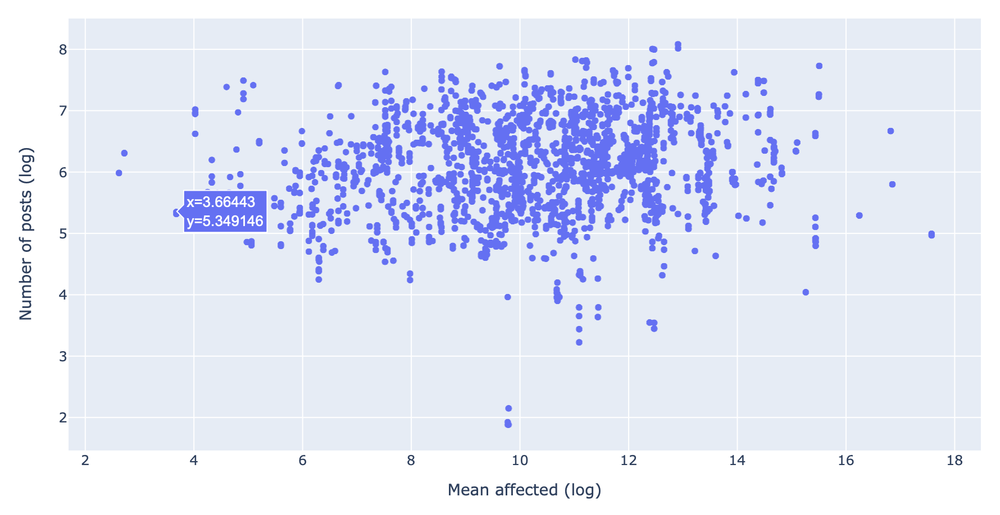

The two don't seem to be corrrelated in any way, we will calculate Pearson:

In [15]:
corr_coef, p = pearsonr(merged_df['mean affected'], merged_df.number_of_posts)
print(f"Correlation coefficient = {corr_coef :.2f} \np-value \t\t= {p:.4f}")

Correlation coefficient = -0.02 
p-value 		= 0.0228


The Pearson Correlation seem to confirm our asummptions, with a significance level of 0.05, we cannot reject our Null-hypothesis based on our p-value. 

Similarly, we'll take a look at Affected People vs. the opinion score: 

In [16]:
scatter = px.scatter(merged_df, x=np.log(merged_df['mean affected']), y=np.log(merged_df.opinion))
scatter.update_xaxes(title_text='Mean affected (log)', row=1, col=1)
scatter.update_yaxes(title_text='Avg. Opinion (log)', row=1, col=1)
fig.write_html("fig5_affectedVsOpinion.html", full_html=False, include_plotlyjs='cdn')
scatter.show()

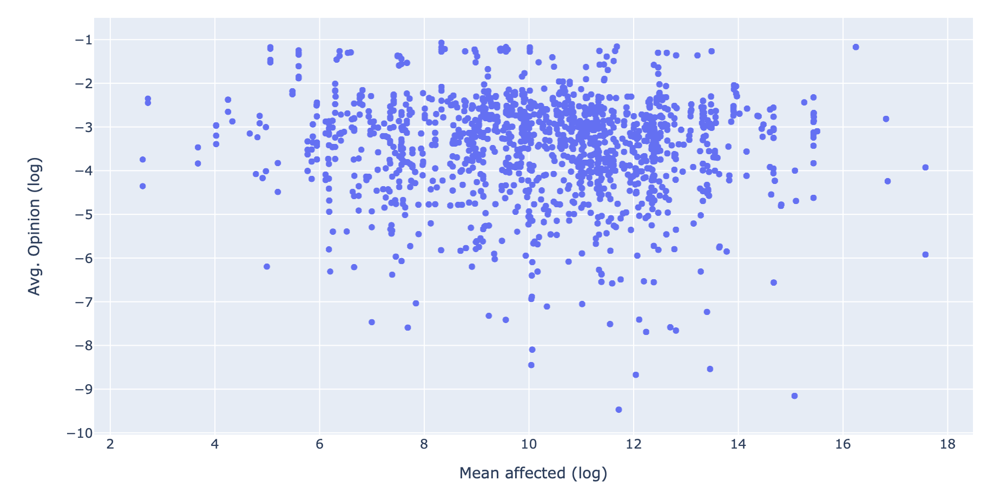

Seems to show th same story. 

Pearson:

In [17]:
corr_coef, p = pearsonr(merged_df['mean affected'], merged_df.opinion)
print(f"Correlation coefficient = {corr_coef :.2f} \np-value \t\t= {p:.4f}")

Correlation coefficient = 0.01 
p-value 		= 0.1648


The Pearson correlation agrees.

Based on the types of data we have available, we can say with certainty that the number of posts / opinion score, don't influence the severity of Natural Disasters - as that would mean that posting on Reddit would cause Natural Disasters. 

Thus, Granger Causality becomes extremely interesting, in order to tell whether the severity of the disasters influence the Redditors. 

### 3.3) Accounting for time variations (attention-span)
We are interested in whether the time series of natural disasters and time series of number of posts- as well as opinions relate to each other in some sense. Therefore, we would like to do a Granger causality test, in order to see whether one variable Granger-causes the other. Firstly, we need to make sure that the time-series are not stationary, i.e. the properties do not depend on the time at which the series were observed. Thus, we will do an Augmented Dickey-Fuller (ADF) test - a test which will determine stationarity, in other words how strongly a time-series is defined by a trend. If we find the time-series to be non-stationary, we will transform the time series to become stationary, as this is the assumption the Granger causality makes. 

Then we propose two models:

> We fit a VAR (Vector autoregression) model on the data and check the correlation of the residuals, a process also needed in the Granger Causality test.  

> We perform a Granger Causality test

Analysis based on this blog post https://towardsdatascience.com/a-quick-introduction-on-granger-causality-testing-for-time-series-analysis-7113dc9420d2.



We'll merge the data into a single merged dataframe

In [18]:
# Merging data into DataFrame
time_series = pd.merge(posts_daily['number_of_posts'], events['mean affected'], how='inner', on='date')
time_series = pd.merge(time_series, posts_daily['opinion'], how='inner', on='date')
time_series = time_series.dropna()

time_series.head()

,number_of_posts,mean affected,opinion
date,,,
2014-11-03,81,11937.908731,0.098361
2014-11-03,81,11937.908731,0.098361
2014-11-03,81,11937.908731,0.098361
2014-11-03,81,11937.908731,0.098361
2014-11-03,81,11937.908731,0.098361


And print the plots we'd like to compute the Granger Causality of. Thus, what we'd like to check is whether the data within the downmost plot is affecting the trends in the two topmost plots. 

In [19]:
posts_fig = px.line(time_series, x=time_series.index, y=time_series.number_of_posts)
opinion_fig = px.line(time_series, x=time_series.index, y=time_series.opinion)
affected_fig = px.line(time_series, x=time_series.index, y=time_series['mean affected'])

# Coloring
posts_fig.update_traces(line_color='#6accbc')
opinion_fig.update_traces(line_color='#158fad')
affected_fig.update_traces(line_color='#14aaf5')
    
fig = make_subplots_from_px([posts_fig, opinion_fig, affected_fig], 'Time-series of the Granger causality test', x_labels = ['', '', 'Date'], y_labels = ['Number of posts', 'Avg. Opinion', 'Mean affected'])
fig.write_html("fig6_Granger.html", full_html=False, include_plotlyjs='cdn')
fig.show()

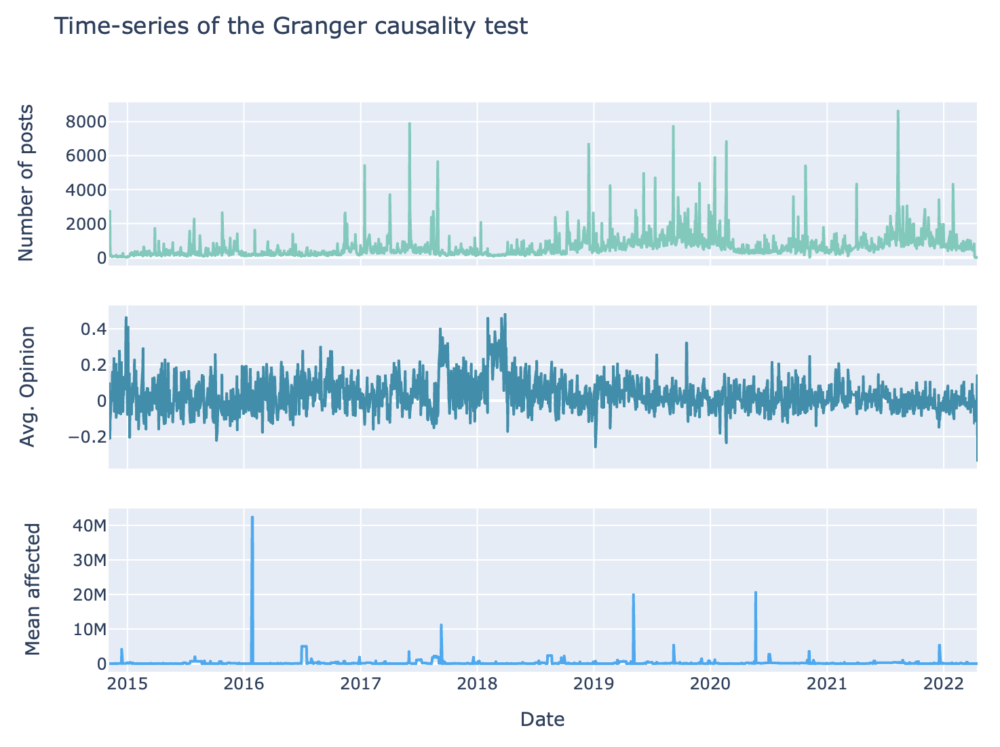

We use an ADF test to determine whether the underlying time series are stationary or not. Null hypothesis: it suggests the time series is not stationarity (if failed to be rejected)

In [20]:
result = adfuller(time_series['number_of_posts'].values)
print(f'ADF Statistics for number of posts: {result[0]}')
print(f'p-value: {result[1]}')

result = adfuller(time_series['opinion'].values)
print(f'ADF Statistics for opinion: {result[0]}')
print(f'p-value: {result[1]}')

result = adfuller(time_series['mean affected'].values)
print(f'ADF Statistics for mean affected: {result[0]}')
print(f'p-value: {result[1]}')

ADF Statistics for number of posts: -13.545313106493216
p-value: 2.4680507739790235e-25
ADF Statistics for opinion: -10.42068697485636
p-value: 1.707835507691755e-18
ADF Statistics for mean affected: -14.398084345258345
p-value: 8.600065648809483e-27


The tiny p-values suggest that the time series are stationary! And as such we can perform both VAR and Granger Causality on our time series. 

The plots and the p-values suggest that theres is no time dependency. We will move on to check correlations.

We will use the VAR model first (Vector autoregression). The VAR class assumes that the passed time series are stationary.

A VAR model describes the evolution of a set of $k$ variables, over time. The variables are collected in a vector, $y_t$, which is of length $k$. The vector is modelled as a linear function of its previous value. The last term is the error term. $$y_t = A_1 y_{t-1} + A_2 y_{t-2} +... A_{p} y_{t-p} + \epsilon$$

The hyperparameter of the model is the number of coefficients we use, basically this means how far we are looking into the past. In Time Series analysis this is called the number of **lags**. We will try models with different lags, The best model will be selected by the minimum AIC score. If we have a model with $k$ parameters, and $L$ is the maximum value of the likelihood function for the model then the AIC score is given by: $AIC = 2k - 2 log(L)$.

In [21]:
def best_lag_by_aic(data):
    model = VAR(data)
    AIC = []
    for i in range(15):
        result = model.fit(i)
        AIC.append(result.aic)
    return np.argmin(AIC)

best_posts = best_lag_by_aic(time_series[['number_of_posts', 'mean affected']])
print(f' Best model for number of posts vs. people affected: {best_posts}')

best_opinion = best_lag_by_aic(time_series[['opinion', 'mean affected']])
print(f' Best model for number of posts vs. people affected: {best_opinion}')

 Best model for number of posts vs. people affected: 14
 Best model for number of posts vs. people affected: 14


We can check the residuals of the fitted models. 

In [22]:
model = VAR(time_series[['number_of_posts', 'mean affected']])
results_post = model.fit(maxlags=best_posts, ic='aic')
print("Correlation of residuals for number of posts and people affected: \n",results_post.resid_corr)

model = VAR(time_series[['opinion', 'mean affected']])
results_opinion = model.fit(maxlags=best_opinion, ic='aic')
print("\nCorrelation of residuals for opinion and people affected: \n",results_opinion.resid_corr)



Correlation of residuals for number of posts and people affected: 
 [[ 1.         -0.02081852]
 [-0.02081852  1.        ]]

Correlation of residuals for opinion and people affected: 
 [[ 1.         -0.01478859]
 [-0.01478859  1.        ]]


The residual errors of the VAR models suggest that none of the time series are correlated with the **people affected**-time series.

### 3.4) Granger Causality 

Now we perform a Granger Causality Test. The Granger causality is a statistical hypothesis test for determining whether one time series is useful in forecasting another. We say that a variable $X$ that evolves over time, Granger-causes another evolving variable $Y$ if predictions of the value of $Y$, based on its own past values **and** on the past values of $X$, are better than predictions of $Y$ based only on $Y$'s own past values.

Formally let $\mathcal{F}(t)$ be the filtration w.r.t. $X$ and $Y$ and let $\mathcal{G}(t)$ be the sub-filtration w.r.t. only $Y$. ($\mathcal{F}(t)$ has more information than $\mathcal{G}(t)$). We want to test the hypothesis that $\mathcal{P}(Y(t+1)\in A| \mathcal{F}(t)) \neq \mathcal{P}(X(t+1)\in A | \mathcal{G}(t))$ for arbitrary measurable set $A$.

In practise we undertake the following steps:
- fit a VAR model to $Y$, that is $y_t=\sum a_i y_{t-i} + \epsilon$
- fit a second VAR model to $Y$ using the information from $X$ as well $y_t =\sum a_i y_{t-i} + \epsilon + \sum b_j x_{t-j} $
- Test the null hypothesis that the coefficients corresponding to past values of the second time series are zero. (We will use chi2 test to do so, another popular option is to use a series of t and F tests)
- We reject the null hypothesis if there exists a significant predictor, in this case we say that $X$ Granger causes $Y$.

In [23]:
def grangers_causation(data, maxlag, test='ssr_chi2test'):    
    test_result = grangercausalitytests(data, maxlag=maxlag, verbose=False)
    p_values = [round(test_result[i+1][0][test][1],4) for i in range(maxlag)]
    min_p_value = np.min(p_values)

    return min_p_value

print('Granger-Causality of whether mean number of affected peoeple, causes number of posts:')
test_result = grangers_causation(time_series[['number_of_posts', 'mean affected']], maxlag=best_posts)
print(f'p-value: {test_result}\n')

print('Granger-Causality of whether mean number of affected peoeple, causes number of posts:')
test_result = grangers_causation(time_series[['opinion', 'mean affected']], maxlag=best_opinion)
print(f'p-value: {test_result}\n')

Granger-Causality of whether mean number of affected peoeple, causes number of posts:
p-value: 0.8426

Granger-Causality of whether mean number of affected peoeple, causes number of posts:
p-value: 0.2818



As the p-values are 0.84 and 0.28 respectively, above our 0.05 significane level, we cannot reject our null-hypotheses. Thus, we cannot conclude that the **mean affected** causes either **number_of_posts** nor **opinion**.

## 4) Conclusion

Based on our thorough investigations, we have come to the conclusion that we cannot conclude that the amount of people affected by extreme climate events are related to number of posts on Reddit, or the opinion of the users on any given date.

We have however been able to conclude, with statistical significance, that the opinion of Redditors regarding climate change is correlated with the amount of posts on any given day. Mainly that, Redditors tend to have an opinion leading towards not believing in manmade climate change on days with many posts on Reddit, regarding climate change. - **This leads us to believe that, though Natural Disasters are not causing a rise in posts, there is some other factor influencing the number of posts regarding climate change on Reddit. This could be anything from Climate Change Awareness protests to Climate Change negotiations within the IPCC, or something completely different.**

All our conclusions, however, heavily depend on whether we trust the decisions of our opinion classifier or not. And as such our conclusions would be more believable with a manually labeled opinion-dataset, however, this is simply not feasible when working with Big Data. 